<a href="https://colab.research.google.com/github/yrodriguezmd/Surgical_instruments/blob/main/Models/notebooks/Student_models/Model_M1_Set_U_oct24/Set_S_U_Model_M1_oct24attempt.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Fine-tune a pretrained VFNet using Set_S then do Inference on Unlabelled Set_U (n= 5560) to generate pseudolabels.

In [ ]:
!wget https://raw.githubusercontent.com/airctic/icevision/master/install_colab.sh
!bash install_colab.sh

In [2]:
exit()

In [ ]:
import icevision

In [2]:
from icevision.all import *
print('icevision v',icevision.__version__)
print('torch v',torch.__version__)
print('torchvision v',torchvision.__version__)

icevision v 0.10.0a1
torch v 1.9.0+cu111
torchvision v 0.10.0+cu111


In [3]:
# contains labelled data
!git clone https://github.com/yrodriguezmd/Surgical_instruments.git

Cloning into 'Surgical_instruments'...
remote: Enumerating objects: 3617, done.
remote: Counting objects: 100% (224/224), done.
remote: Compressing objects: 100% (208/208), done.
remote: Total 3617 (delta 85), reused 9 (delta 9), pack-reused 3393
Receiving objects: 100% (3617/3617), 171.56 MiB | 2.94 MiB/s, done.
Resolving deltas: 100% (948/948), done.
Checking out files: 100% (4162/4162), done.


In [4]:
# contains unlabelled data
from google.colab import drive
drive.mount('/content/gdrive', force_remount = True)

Mounted at /content/gdrive


In [ ]:
!ls Surgical_instruments/Sets/Set_S/subsets/Set_1_7

notebooks  README.md  test  train  valid  whole_set


In [ ]:
!ls gdrive/MyDrive/Surgical_instruments/

Models		 Set_1_3.v1i.coco  Set_2.v1i.coco  Set_U2
pseudolabels	 Set_1_5.v1i.coco  Set_U	   Set_U3
retained_images  Set_1.v1i.coco    Set_U1


Train Model_M

In [ ]:
image_path = Path('Surgical_instruments/Sets/Set_S/subsets/Set_1_7/train')

img_files = get_image_files(image_path)

img = PIL.Image.open(img_files[601]) ##
img = img.convert('RGB')

#img.to_thumb(150,150)

In [5]:
classes = ['Towel_clip', 'Castroviejo', 'Yankauer', 'Hemostat', 'Army_navy', 'Richardson', 'Potts', 'Iris', 'Bulldog', 'Forceps', 'Scalpel', 'Frazier', 'Needle', 'Weitlaner', 'Mayo_metz']
class_map = ClassMap(classes)
len(class_map)

16

Parse data

In [ ]:
path = Path('Surgical_instruments/Sets/Set_S/subsets/Set_1_7') # adjust if use git clone vs gdrive
#path = Path('gdrive/MyDrive/Surgical_instruments/Set_1_5.v1i.coco')

train_parser = parsers.COCOBBoxParser(
    annotations_filepath = path/'train/Set_1_7_annotations.coco.json',
    #annotations_filepath = path/'train/Set_1_5_annotations.coco.json',
    #img_dir = path/'train'
    img_dir = path/'train'
)

valid_parser = parsers.COCOBBoxParser(
    annotations_filepath = path/'valid/Set_1_7_annotations.coco.json',
    #annotations_filepath = path/'valid/Set_1_5_annotations.coco.json',
    #img_dir = path/'valid'
    img_dir = path/'valid'
)

In [ ]:
# dataset already split in annotation tool, maintain grouping

whole = SingleSplitSplitter()

train_records, *_ = train_parser.parse(data_splitter = whole)

valid_records, *_ = valid_parser.parse(data_splitter = whole)

  0%|          | 0/1323 [00:00<?, ?it/s]

INFO     - Autofixing records | icevision.parsers.parser:parse:122


  0%|          | 0/677 [00:00<?, ?it/s]

  0%|          | 0/361 [00:00<?, ?it/s]

INFO     - Autofixing records | icevision.parsers.parser:parse:122


  0%|          | 0/186 [00:00<?, ?it/s]

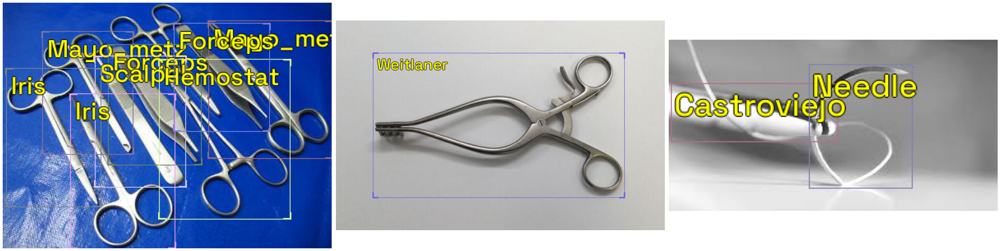

In [ ]:
show_records(train_records[0:3],ncols=3, font_size=30, label_color = '#ffff00')

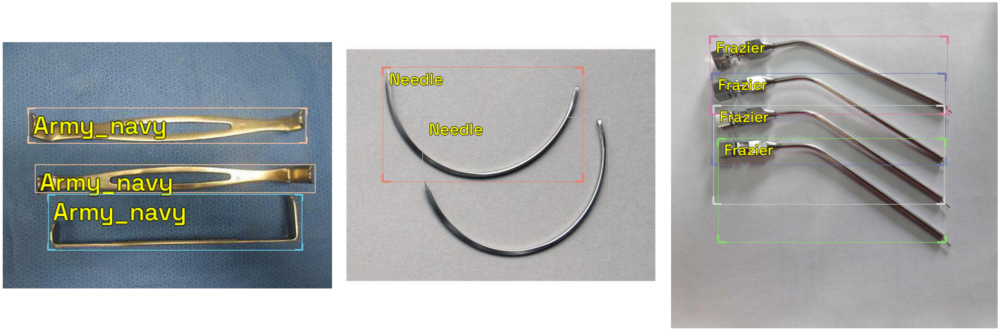

In [ ]:
show_records(valid_records[0:3],ncols=3, font_size=30, label_color = '#ffff00')

In [ ]:
presize = 512
image_size = 384

train_tfms = tfms.A.Adapter([*tfms.A.aug_tfms(size=presize), tfms.A.Normalize()])
valid_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(size=image_size), tfms.A.Normalize()])

In [ ]:
train_ds = Dataset(train_records, train_tfms) ## Set_S labelled + Set_U1 pseudolabels
valid_ds = Dataset(valid_records, valid_tfms)

In [ ]:
metrics = [COCOMetric(metric_type=COCOMetricType.bbox)]

from icevision.models.checkpoint import *

model_type = models.mmdet.vfnet ##
backbone = model_type.backbones.resnet50_fpn_mstrain_2x##

model = model_type.model(backbone=backbone(pretrained=True), num_classes=len(class_map),)# **extra_args)

In [ ]:
# manual upload model
#from google.colab import files
#files.upload()

For this run, skip modelling.  Use Model_M

In [ ]:
from icevision.models import *

checkpoint_path = 'Model_M_oct23_vf_mAP52.5.pth'

checkpoint_and_model = model_from_checkpoint(checkpoint_path)
model = checkpoint_and_model['model'] # Model M
model.train()

In [ ]:
train_dl = model_type.train_dl(train_ds, batch_size = 16, num_workers = 4,
                               shuffle=True)
valid_dl = model_type.valid_dl(valid_ds, batch_size=16, num_workers = 4,
                               shuffle=False)

In [ ]:
from fastai.callback.wandb import *

wandb.init(project = 'Surgical_instruments', name = 'Model_M1_oct24', ##
           reinit = True)

<IPython.core.display.Javascript object>

In [ ]:
learn = model_type.fastai.learner(dls = [train_dl, valid_dl],
                                  model = model, metrics = metrics,#)
                                  cbs = WandbCallback(  )) ##

In [ ]:
learn.lr_find()

In [ ]:
learn.fine_tune(10,1e-03)##

In [ ]:
learn.fine_tune(20,1e-03)## 30


In [ ]:
import matplotlib.pyplot as plt
def plot_metrics(learn, title):
  plt.plot(L(learn.recorder.values).itemgot())
  plt.xlabel('epoch')
  plt.ylabel('mAP (green), Loss (blue, orange)')
  plt.title(title)
  plt.text(0,-0.2, 
       'Legend: mAP(green), train_loss(blue), valid_loss(orange')
  plt.ylim(0,1);

In [ ]:
plot_metrics(learn, 'Model_M__, ')

In [ ]:
import matplotlib.pyplot as plt
def plot_metrics(learn, title):
  plt.plot(L(learn.recorder.values).itemgot())
  plt.xlabel('epoch')
  plt.ylabel('mAP (green), Loss (blue, orange)')
  plt.title(title)
  plt.text(0,-0.2, 
       'Legend: mAP(green), train_loss(blue), valid_loss(orange')
  plt.ylim(0,2);

In [ ]:
plot_metrics(learn, 'Model_M__')

In [ ]:
model_type.show_results(model, valid_ds)

In [ ]:
model_type.show_results(model, valid_ds)

In [ ]:
from icevision.models import *

checkpoint_path = 'Model_M_oct23_vf_mAP52.5.pth'

save_icevision_checkpoint(model, 
                        model_name='mmdet.vfnet', ## 
                        backbone_name='resnet50_fpn_mstrain_2x', ##
                        classes =  train_parser.class_map.get_classes(), 
                        img_size=image_size, 
                        filename=checkpoint_path,
                        meta={'icevision_version': '0.9.1'})

# download model

Inference using Set_S test_set

In [ ]:
model.eval()

In [ ]:
path = Path('Surgical_instruments/Sets/Set_S/subsets/Set_1_7') # adjust if use git clone vs gdrive

test_parser = parsers.COCOBBoxParser(
    annotations_filepath = path/'test/Set_1_7_annotations.coco.json',
    #annotations_filepath = path/'train/Set_1_5_annotations.coco.json',
    #img_dir = path/'train'
    img_dir = path/'test')

whole = SingleSplitSplitter()

test_records, *_ = test_parser.parse(data_splitter = whole)

#show_records(test_records[0:3],ncols=3, font_size=30, label_color = '#ffff00')

  0%|          | 0/185 [00:00<?, ?it/s]

INFO     - Autofixing records | icevision.parsers.parser:parse:122


  0%|          | 0/93 [00:00<?, ?it/s]

In [ ]:
classes = ['Towel_clip', 'Castroviejo', 'Yankauer', 'Hemostat', 'Army_navy', 'Richardson', 'Potts', 'Iris', 'Bulldog', 'Forceps', 'Scalpel', 'Frazier', 'Needle', 'Weitlaner', 'Mayo_metz']
class_map = ClassMap(classes)

In [ ]:
img_size = 384 

valid_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(img_size), tfms.A.Normalize()])

#infer_ds = Dataset.from_images(imgs_array, valid_tfms, class_map = class_map)
infer_ds = Dataset(test_records, valid_tfms)#, class_map = class_map)

In [ ]:
infer_dl = model_type.infer_dl(infer_ds, 
                               batch_size=4, shuffle=False)

preds_saved = model_type.predict_from_dl(model, infer_dl,
                                          keep_images=True, 
                                         detection_threshold = 0.5) ##

  0%|          | 0/24 [00:00<?, ?it/s]

In [ ]:
#test
show_preds(preds = preds_saved[0:10])
# with detection threshold 0.5

In [ ]:
show_preds(preds = preds_saved[10:20])

Do inference on Set_U to generate pseudolabels.

In [ ]:
!ls gdrive/MyDrive/Surgical_instruments
# Set_U with ** images

Models		 Set_1_3.v1i.coco  Set_2.v1i.coco  Set_U2
pseudolabels	 Set_1_5.v1i.coco  Set_U	   Set_U3
retained_images  Set_1.v1i.coco    Set_U1


In [ ]:
images = Path('gdrive/MyDrive/Surgical_instruments/Set_U')

img_files = get_image_files(images)

img = PIL.Image.open(img_files[5001])
#img = img.convert('RGB')

img.to_thumb(150,150)

In [ ]:
# same classes

imgs_array = [PIL.Image.open(file) for file in img_files]

imgs_array = [image.convert('RGB') for image in imgs_array]

img_size = 384 

valid_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(img_size), tfms.A.Normalize()])

infer_ds = Dataset.from_images(imgs_array, valid_tfms, class_map = class_map)

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


In [ ]:
infer_dl = model_type.infer_dl(infer_ds,## 
                               batch_size=4, shuffle=False)

preds_saved = model_type.predict_from_dl(model, infer_dl,
                                          keep_images=True, 
                                         detection_threshold = 0.5)

  0%|          | 0/1396 [00:00<?, ?it/s]

In [ ]:
show_preds (preds = preds_saved[0:10])

In [ ]:
show_preds (preds = preds_saved[10:20])

Generate annotation file

In [ ]:
for pred in preds_saved:
  pred.add_component(FilepathRecordComponent())

for _ in range(len(preds_saved)): 
  preds_saved[_].set_filepath(img_files[_]) 

conv = convert_preds_to_coco_style(preds_saved) 

In [ ]:
conv.items()

dict_items([('images', [{'id': 0, 'file_name': 'Unlabelled01073.jpg', 'width': 384, 'height': 384}, {'id': 1, 'file_name': 'Unlabelled01074.jpg', 'width': 384, 'height': 384}, {'id': 2, 'file_name': 'Unlabelled01075.jpg', 'width': 384, 'height': 384}, {'id': 3, 'file_name': 'Unlabelled01076.jpg', 'width': 384, 'height': 384}, {'id': 4, 'file_name': 'Unlabelled01077.jpg', 'width': 384, 'height': 384}, {'id': 5, 'file_name': 'Unlabelled01078.jpg', 'width': 384, 'height': 384}, {'id': 6, 'file_name': 'Unlabelled01079.jpg', 'width': 384, 'height': 384}, {'id': 7, 'file_name': 'Unlabelled01080.jpg', 'width': 384, 'height': 384}, {'id': 8, 'file_name': 'Unlabelled01081.jpg', 'width': 384, 'height': 384}, {'id': 9, 'file_name': 'Unlabelled01082.jpg', 'width': 384, 'height': 384}, {'id': 10, 'file_name': 'Unlabelled01083.jpg', 'width': 384, 'height': 384}, {'id': 11, 'file_name': 'Unlabelled01084.jpg', 'width': 384, 'height': 384}, {'id': 12, 'file_name': 'Unlabelled01085.jpg', 'width': 384, '

In [ ]:
add_info = {
    "info": {
        "year": "2021",
        "version": "1",
        "description": "Exported from roboflow.ai",
        "contributor": "",
        "url": "https://public.roboflow.ai/object-detection/undefined",
        "date_created": "2021-10-05T20:13:09+00:00"
    },
    "licenses": [
        {
            "id": 1,
            "url": "https://creativecommons.org/licenses/by/4.0/",
            "name": "CC BY 4.0"
        }
    ],
    "categories": [
        {
            "id": 0,
            "name": "instruments",
            "supercategory": "none"
        },
        {
            "id": 1,
            "name": "Army_navy",
            "supercategory": "Retractor"
        },
        {
            "id": 2,
            "name": "Bulldog",
            "supercategory": "Clamp"
        },
        {
            "id": 3,
            "name": "Castroviejo",
            "supercategory": "Needle_holder"
        },
        {
            "id": 4,
            "name": "Forceps",
            "supercategory": "Forceps"
        },
        {
            "id": 5,
            "name": "Frazier",
            "supercategory": "Suction"
        },
        {
            "id": 6,
            "name": "Hemostat",
            "supercategory": "Clamp"
        },
        {
            "id": 7,
            "name": "Iris",
            "supercategory": "Scissors"
        },
       {
            "id": 8,
            "name": "Mayo_metz",
            "supercategory": "Scissors"
        },
        {
            "id": 9,
            "name": "Needle",
            "supercategory": "Needle"
        },
        {
            "id": 10,
            "name": "Potts",
            "supercategory": "Scissors"
        },
        {
            "id": 11,
            "name": "Richardson",
            "supercategory": "Retractor"
        },
        {
            "id": 12,
            "name": "Scalpel",
            "supercategory": "Scalpel"
        },
        {
            "id": 13,
            "name": "Towel_clip",
            "supercategory": "Clamp"
        },
        {
            "id": 14,
            "name": "Weitlaner",
            "supercategory": "Retractor"
        },
        {
            "id": 15,
            "name": "Yankauer",
            "supercategory": "Suction"
        }
    ]
}

In [ ]:
pseudo_U = {**add_info, **conv} ##

f = open('pseudo_U.json','w') ##
f.write(str(pseudo_U)) ##
f.close()
##  edit ' to ": pseudo_U_.json 
##    --> challenging with big file, however, quotations necessary

Parse labelled and pseudolabelled data.

In [ ]:
#labelled data
! git clone https://github.com/yrodriguezmd/Surgical_instruments.git

In [ ]:
!ls gdrive/MyDrive/Surgical_instruments/

Models		  Set_1_5.v1i.coco  Set_2.v1i.coco
Set_1_3.v1i.coco  Set_1.v1i.coco    Set_U1


In [9]:
# Use Set_1_7 labelled data
labelled_path = Path('Surgical_instruments/Sets/Set_S/subsets/Set_1_7')
pseudolabelled_path = Path('gdrive/MyDrive/Surgical_instruments/Set_U')

lab_train_parser = parsers.COCOBBoxParser(
    annotations_filepath = labelled_path/'train/Set_1_7_annotations.coco.json',
    img_dir = labelled_path/'train'
)

ps_train_parser = parsers.COCOBBoxParser(
    annotations_filepath = 'pseudo_U_.json', ## 
    img_dir = pseudolabelled_path
)

valid_parser = parsers.COCOBBoxParser(
    annotations_filepath = labelled_path/'valid/Set_1_7_annotations.coco.json',
    img_dir = labelled_path/'valid'
)

In [ ]:
whole = SingleSplitSplitter()

train_records, *_ = lab_train_parser.parse(data_splitter = whole)

In [ ]:
valid_records, *_ = valid_parser.parse(data_splitter = whole)

In [ ]:
train_records_ps, *_ = ps_train_parser.parse(data_splitter = whole)

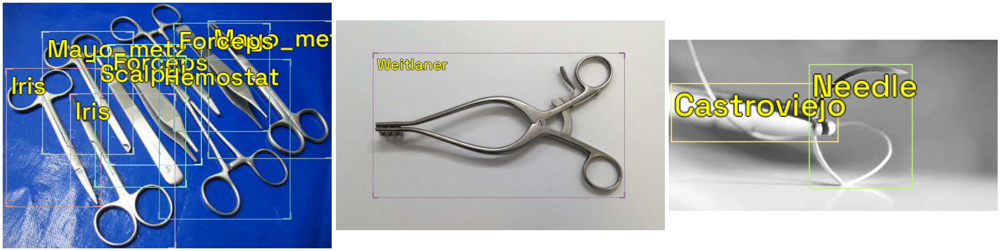

In [16]:
show_records(train_records[0:3],ncols=3, font_size=30, label_color = '#ffff00')

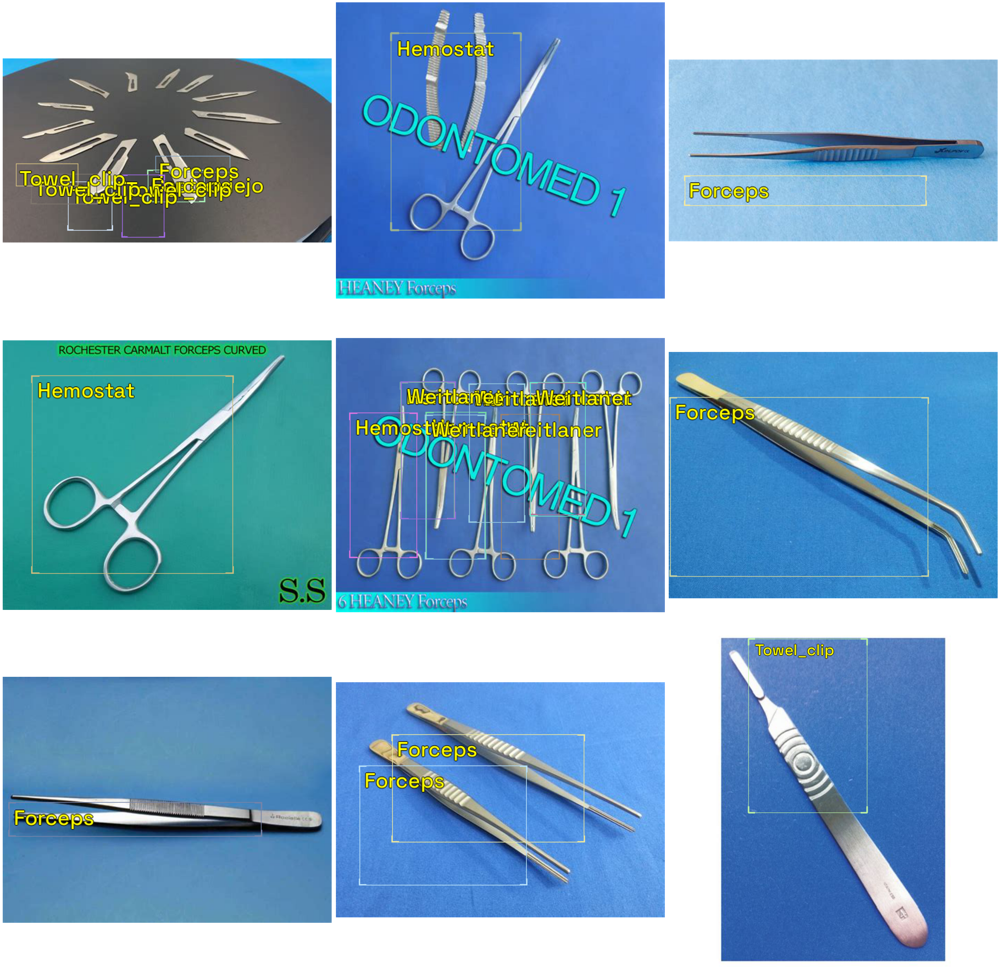

In [18]:
show_records(train_records_ps[0:9],ncols=3, font_size=30, label_color = '#ffff00')

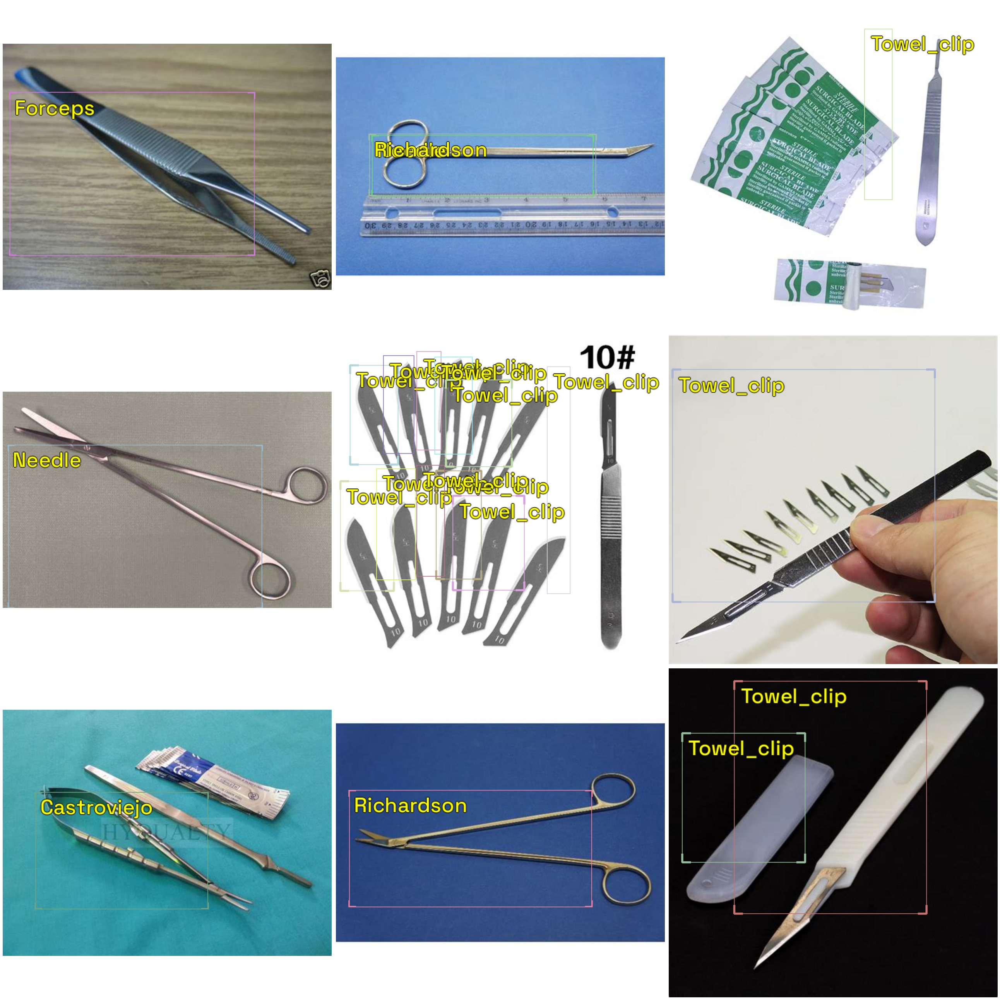

In [19]:
show_records(train_records_ps[9:18],ncols=3, font_size=30, label_color = '#ffff00')

Merge labelled records and pseudolabelled records

In [20]:
merged_train_records = torch.utils.data.ConcatDataset([train_records, train_records_ps])
print(len(train_records))
print(len(train_records_ps))
print(len(merged_train_records))

677
5235
5912


In [21]:
N = 5560 # Set_U
1- ( (N - len(train_records_ps)) / N)
# 94% of the unlabelled images have pseudolabels

0.9415467625899281

Retained images

In [ ]:
Set_U_a = [] # retained images (no pseudolabels)
for x in range(len(preds_saved)):
  if preds_saved[x].pred.detection.labels ==[]:
    Set_U_a.append(preds_saved[x].pred.common.filepath)


In [ ]:
Set_U_a[0]

Path('gdrive/MyDrive/Surgical_instruments/Set_U2/Unlabelled02558.jpg')

In [ ]:
# keep for records
f = open('Set_U_a','w') 
f.write(str(Set_U_a)) 
f.close()
# download locally

In [ ]:
imgs_retained = [PIL.Image.open(file) for file in Set_U_a]

retained_ds = Dataset.from_images(imgs_retained, valid_tfms, class_map = class_map)

retained_ds

<Dataset with 110 items>

Train student model Model_M1_oct24 using merged labelled and pseudolabelled data (merged_train_records).

In [23]:
presize = 512
image_size = 384

train_tfms = tfms.A.Adapter([*tfms.A.aug_tfms(size=presize), tfms.A.Normalize()])
valid_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(size=image_size), tfms.A.Normalize()])

In [24]:
train_ds = Dataset(merged_train_records, train_tfms) ## Set_S labelled + Set_U pseudolabels
valid_ds = Dataset(valid_records, valid_tfms)

In [25]:
metrics = [COCOMetric(metric_type=COCOMetricType.bbox)]

from icevision.models.checkpoint import *

model_type = models.mmdet.vfnet ##
backbone = model_type.backbones.resnet50_fpn_mstrain_2x##

#model = model_type.model(backbone=backbone(pretrained=True), num_classes=len(class_map),)# **extra_args)

In [ ]:
from icevision.models import *

checkpoint_path = 'Model_M_oct23_vf_mAP52.5.pth'

checkpoint_and_model = model_from_checkpoint(checkpoint_path)
model = checkpoint_and_model['model'] # Model M
model.train()

In [27]:
train_dl = model_type.train_dl(train_ds, batch_size = 16, num_workers = 4,
                               shuffle=True)
valid_dl = model_type.valid_dl(valid_ds, batch_size=16, num_workers = 4,
                               shuffle=False)

In [29]:
from fastai.callback.wandb import *

wandb.init(project = 'Surgical_instruments', name = 'Model_M1_oct24', ##
           reinit = True)

<IPython.core.display.Javascript object>

wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [31]:
learn = model_type.fastai.learner(dls = [train_dl, valid_dl],
                                  model = model, metrics = metrics,#)
                                  cbs = WandbCallback(  )) ##

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:324: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:361: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  '``single_level_grid_anchors`` would be deprecated soon. '
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in

SuggestedLRs(valley=0.0003311311302240938)

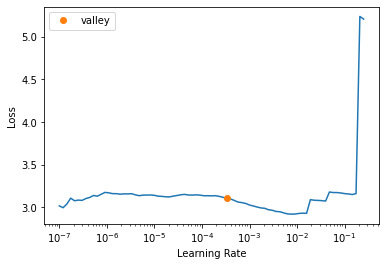

In [32]:
learn.lr_find()

In [33]:
#merged
learn.fine_tune(10, 3e-04 )

Could not gather input dimensions
WandbCallback requires use of "SaveModelCallback" to log best model
WandbCallback was not able to prepare a DataLoader for logging prediction samples -> 'Dataset' object has no attribute 'items'


epoch,train_loss,valid_loss,COCOMetric,time
0,2.093907,1.821593,0.416164,05:09


/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:324: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:361: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  '``single_level_grid_anchors`` would be deprecated soon. '
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: P

Could not gather input dimensions


epoch,train_loss,valid_loss,COCOMetric,time
0,1.986353,1.707182,0.437436,05:39
1,1.999754,1.799330,0.397189,05:38
2,1.964605,1.810379,0.396991,05:38
3,1.940524,1.890907,0.364093,05:38
4,1.894715,1.871618,0.341345,05:38
5,1.879467,1.882350,0.329335,05:39
6,1.817488,1.904897,0.321894,05:39
7,1.785481,1.946185,0.294778,05:39
8,1.767242,1.897787,0.323341,05:38
9,1.772474,1.895901,0.327236,05:39


/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency e

In [34]:
learn.fine_tune(10,3e-04) #20

Could not gather input dimensions


epoch,train_loss,valid_loss,COCOMetric,time
0,1.846381,1.921159,0.294221,05:09


/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:324: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:361: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  '``single_level_grid_anchors`` would be deprecated soon. '
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: P

Could not gather input dimensions


epoch,train_loss,valid_loss,COCOMetric,time
0,1.797441,1.934728,0.296866,05:39
1,1.796072,1.922692,0.321810,05:39
2,1.835622,1.897978,0.329010,05:38
3,1.810558,1.937840,0.279534,05:39
4,1.783301,2.011286,0.261246,05:39
5,1.764099,1.948399,0.294219,05:38
6,1.681981,1.997352,0.286315,05:39
7,1.656735,1.962177,0.299263,05:39
8,1.630181,1.963421,0.302883,05:39
9,1.630165,1.967020,0.301676,05:38


/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency e

In [35]:
learn.fine_tune(10,3e-04) #30

Could not gather input dimensions


epoch,train_loss,valid_loss,COCOMetric,time
0,1.722403,2.023585,0.259631,05:08


/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:324: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:361: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  '``single_level_grid_anchors`` would be deprecated soon. '
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: P

Could not gather input dimensions


epoch,train_loss,valid_loss,COCOMetric,time
0,1.656124,1.982635,0.292620,05:39
1,1.692654,1.912515,0.325632,05:38
2,1.736463,1.999043,0.304022,05:38
3,1.694084,2.015368,0.266932,05:39
4,1.684374,2.069560,0.246541,05:39
5,1.685438,1.992677,0.284323,05:39
6,1.624701,2.029040,0.266556,05:38
7,1.591762,2.057722,0.277865,05:38
8,1.538045,2.087390,0.282492,05:39
9,1.515993,2.082501,0.282623,05:38


/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency e

In [36]:
learn.fine_tune(10,3e-04) #40

Could not gather input dimensions


epoch,train_loss,valid_loss,COCOMetric,time
0,1.625090,2.047723,0.272443,05:08


/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:324: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:361: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  '``single_level_grid_anchors`` would be deprecated soon. '
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: P

Could not gather input dimensions


epoch,train_loss,valid_loss,COCOMetric,time
0,1.556229,2.107989,0.275269,05:38
1,1.612093,2.048376,0.276740,05:38
2,1.619868,2.020731,0.299736,05:38
3,1.667983,2.035872,0.269747,05:38
4,1.614426,2.043621,0.256425,05:38
5,1.584917,2.057170,0.252072,05:38
6,1.521887,2.105126,0.248262,05:38
7,1.509213,2.095288,0.276082,05:38
8,1.452342,2.119781,0.262796,05:39
9,1.460943,2.118272,0.271012,05:38


/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency e

In [ ]:
import matplotlib.pyplot as plt
def plot_metrics(learn, title):
  plt.plot(L(learn.recorder.values).itemgot())
  plt.xlabel('epoch')
  plt.ylabel('mAP (green), Loss (blue, orange)')
  plt.title(title)
  plt.text(0,-0.2, 
       'Legend: mAP(green), train_loss(blue), valid_loss(orange')
  plt.ylim(0,1);

In [ ]:
plot_metrics(learn, 'Model_M1_oct23')

In [37]:
import matplotlib.pyplot as plt
def plot_metrics(learn, title):
  plt.plot(L(learn.recorder.values).itemgot())
  plt.xlabel('epoch')
  plt.ylabel('mAP (green), Loss (blue, orange)')
  plt.title(title)
  plt.text(0,-0.2, 
       'Legend: mAP(green), train_loss(blue), valid_loss(orange')
  plt.ylim(0,2);

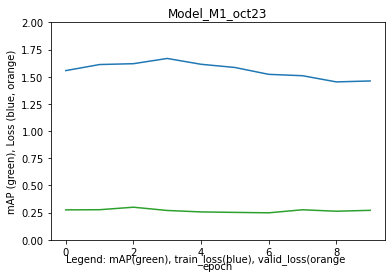

In [38]:
plot_metrics(learn, 'Model_M1_oct23')

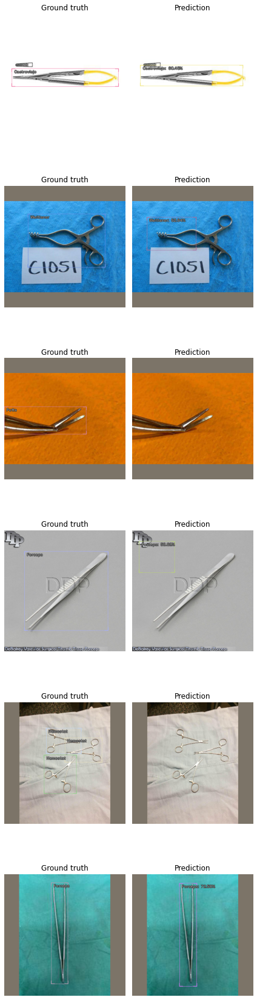

In [39]:
model_type.show_results(model, valid_ds)

In [51]:
from icevision.models import *

checkpoint_path = 'Model_M1_oct24_vf_mAP27.1.pth'

save_icevision_checkpoint(model, 
                        model_name='mmdet.vfnet', ## 
                        backbone_name='resnet50_fpn_mstrain_2x', ##
                        classes =  valid_parser.class_map.get_classes(), 
                        img_size=image_size, 
                        filename=checkpoint_path,
                        meta={'icevision_version': '0.9.1'})

# download model

Inference using Set_S test_set

In [ ]:
model.eval()

  0%|          | 0/185 [00:00<?, ?it/s]

INFO     - Autofixing records | icevision.parsers.parser:parse:122


  0%|          | 0/93 [00:00<?, ?it/s]

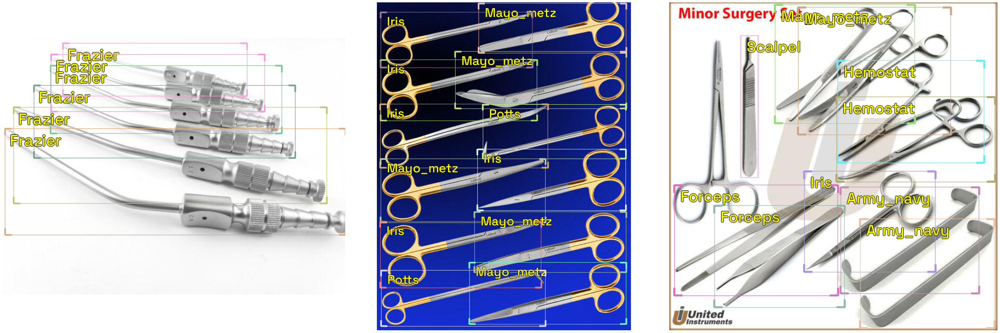

In [41]:
path = Path('Surgical_instruments/Sets/Set_S/subsets/Set_1_7') # adjust if use git clone vs gdrive

test_parser = parsers.COCOBBoxParser(
    annotations_filepath = path/'test/Set_1_7_annotations.coco.json',
    #annotations_filepath = path/'train/Set_1_5_annotations.coco.json',
    #img_dir = path/'train'
    img_dir = path/'test')

whole = SingleSplitSplitter()

test_records, *_ = test_parser.parse(data_splitter = whole)

show_records(test_records[0:3],ncols=3, font_size=30, label_color = '#ffff00')

In [42]:
classes = ['Towel_clip', 'Castroviejo', 'Yankauer', 'Hemostat', 'Army_navy', 'Richardson', 'Potts', 'Iris', 'Bulldog', 'Forceps', 'Scalpel', 'Frazier', 'Needle', 'Weitlaner', 'Mayo_metz']
class_map = ClassMap(classes)

In [43]:
img_size = 384 

valid_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(img_size), tfms.A.Normalize()])

#infer_ds = Dataset.from_images(imgs_array, valid_tfms, class_map = class_map)
infer_ds = Dataset(test_records, valid_tfms)#, class_map = class_map)

In [46]:
infer_dl = model_type.infer_dl(infer_ds, 
                               batch_size=4, shuffle=False)

preds_saved_test = model_type.predict_from_dl(model, infer_dl,
                                          keep_images=True, 
                                         detection_threshold = 0.5) ##

  0%|          | 0/24 [00:00<?, ?it/s]

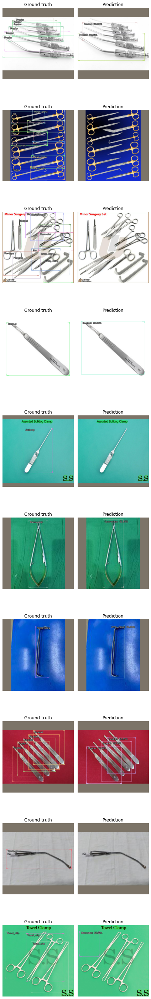

In [47]:
show_preds(preds = preds_saved_test[0:10])
# with detection threshold 0.5

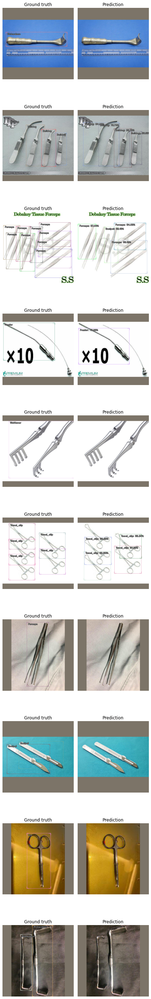

In [48]:
show_preds(preds = preds_saved_test[10:20])


In [52]:
learn.fine_tune(10, 3e-04)

Could not gather input dimensions


epoch,train_loss,valid_loss,COCOMetric,time
0,1.535574,2.110270,0.234372,05:08


/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:324: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/usr/local/lib/python3.7/dist-packages/mmdet/core/anchor/anchor_generator.py:361: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  '``single_level_grid_anchors`` would be deprecated soon. '
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: P

Could not gather input dimensions


epoch,train_loss,valid_loss,COCOMetric,time
0,1.499370,2.165751,0.239109,05:38
1,1.536509,2.026960,0.294920,05:38
2,1.584985,2.072037,0.256661,05:38
3,1.559930,2.065499,0.283162,05:38
4,1.575420,2.072252,0.236220,05:38
5,1.504611,2.152344,0.230294,05:39
6,1.455124,2.121211,0.272005,05:38
7,1.416932,2.183600,0.259146,05:38
8,1.400068,2.164762,0.263308,05:38
9,1.395276,2.175451,0.261156,05:38


/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.7/dist-packages/PIL/Image.py:976: UserWarning: Palette images with Transparency e

In [ ]:
### consider what to do with retained images
### if model is giving good mAP and inference, do inference using the student model
###    to get pseudolabels, then retrain
### if model not good, annotate more data